In [1]:
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import time
from PIL import Image

# Config

Just an easily accessible config to make changes to the network.

In [2]:
# Set random seed for reproducibility
seed = 42
random.seed(seed)
torch.manual_seed(seed)

# Path to data
data_path = "data/"

##### Data Parameters

# Batch Size
batch_size = 64
image_size = 64
channels = 3

##### Model Parameters

# Size of generator input
latent_dimensions = 100

# Size of feature maps for generator
generator_feature_maps = 64

# Size of feature maps for discriminator
discriminator_feature_maps = 64

num_epochs = 50
learning_rate = 0.0015

# beta1 hyperparameter for Adam
beta1 = 0.5

Putting this here since it's used everywhere anyway.

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Data 

Not much in the way of preprocessing. We just resize to 64x64 since some images are 96x96 and others are 80x80 and it's easier to write this stuff for powers of 2. We use a CenterCrop to focus on the central area of the sprite. Add in a couple of random horizontal flips so not all sprites of the same Pokemon look similar. And finally just a standard normalization to -1 to 1.

There's another issue where the dpp sprites have a different background than the other two. From what I've read, it's because one had a black background before being made transparent and the other had a white background. The function below just makes everything have a white background.

In [4]:
def convert_transparent_background_to_white(img):
    x = np.asarray(img).copy()
    r, g, b, a = np.rollaxis(x, axis = -1)
    r[a == 0] = 255
    g[a == 0] = 255
    b[a == 0] = 255
    x = np.dstack([r, g, b, a])
    return Image.fromarray(x).convert('RGB')

Need a custom loader since by default ImageFolder loads it as RGB.

In [5]:
def rgba_loader(path):
    with open(path, 'rb') as f:
        img = Image.open(f)
        return img.convert('RGBA')

In [6]:
dataset = dset.ImageFolder(root=data_path,
                           transform=transforms.Compose([
                               # Resize image to image_size x image_size if it isn't already
                               transforms.Resize(image_size),
                               # Crops the image to the center while resizing
                               transforms.CenterCrop(image_size),
                               # Flips images horizontally with a probability of 0.5
                               # Using this because most of the images of Pokemon with many sprites
                               # Are in the same 'direction'
                               transforms.RandomHorizontalFlip(0.5),
                               # Converts the transparent background to white
                               transforms.Lambda(lambda x: convert_transparent_background_to_white(x)),
                               # Convert to a tensor
                               transforms.ToTensor(),
                               # Normalize with mean = 0.5 & s.d. = 0.5 for all 3 channels
                               # So data is in the range -1 to +1
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]),
                           loader = rgba_loader)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True)

Taking a look at our data.

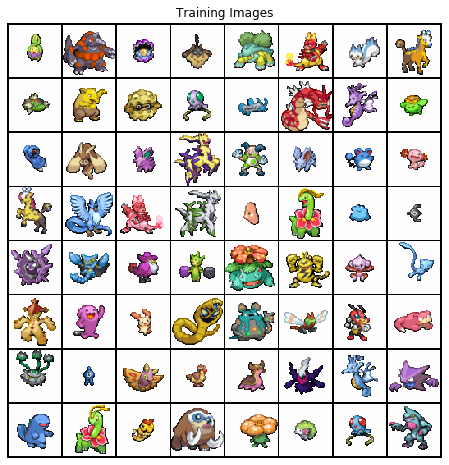

In [7]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# The Model

A random weight initialization from a normal distribution apparently helps a lot. So..

In [8]:
def weights_init(m):
    """
    Initializes weights randomly from a normal distribution (mean=0, stdev=0.02).
    Does this for all conv, conv-transpose, & batch norm layers of a model.
    """
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

Creating a standard DCGAN

In [9]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Noise = 100x1x1
            nn.ConvTranspose2d(in_channels = latent_dimensions, out_channels = generator_feature_maps * 8,
                                   kernel_size = 4, stride = 1, padding = 0, bias=False),
            nn.BatchNorm2d(num_features = generator_feature_maps * 8),
            nn.ReLU(inplace = True),
            # 512x4x4
            nn.ConvTranspose2d(in_channels = generator_feature_maps * 8, out_channels = generator_feature_maps * 4,
                                   kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.BatchNorm2d(num_features = generator_feature_maps * 4),
            nn.ReLU(inplace = True),
            # 256x8x8
            nn.ConvTranspose2d(in_channels = generator_feature_maps * 4, out_channels = generator_feature_maps * 2,
                                   kernel_size = 4, stride = 2,  padding = 1, bias=False),
            nn.BatchNorm2d(num_features = generator_feature_maps * 2),
            nn.ReLU(inplace = True),
            # 128x16x16
            nn.ConvTranspose2d(in_channels = generator_feature_maps * 2, out_channels = generator_feature_maps,
                                   kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.BatchNorm2d(num_features = generator_feature_maps),
            nn.ReLU(inplace = True),
            # 64x32x32
            nn.ConvTranspose2d( generator_feature_maps, channels, 4, 2, 1, bias=False),
            # 3x64x64 = Image
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Image = 3x64x64
            nn.Conv2d(in_channels = channels, out_channels = discriminator_feature_maps, 
                          kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.LeakyReLU(negative_slope = 0.2, inplace = True),
            # 64x32x32
            nn.Conv2d(in_channels = discriminator_feature_maps, out_channels = discriminator_feature_maps * 2, 
                          kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.BatchNorm2d(num_features = discriminator_feature_maps * 2),
            nn.LeakyReLU(negative_slope = 0.2, inplace = True),
            # 128x16x16
            nn.Conv2d(in_channels = discriminator_feature_maps * 2, out_channels = discriminator_feature_maps * 4, 
                          kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.BatchNorm2d(num_features = discriminator_feature_maps * 4),
            nn.LeakyReLU(negative_slope = 0.2, inplace = True),
            # 256x8x8
            nn.Conv2d(in_channels = discriminator_feature_maps * 4, out_channels = discriminator_feature_maps * 8,
                          kernel_size = 4, stride = 2, padding = 1, bias=False),
            nn.BatchNorm2d(num_features = discriminator_feature_maps * 8),
            nn.LeakyReLU(negative_slope = 0.2, inplace = True),
            # 512x4x4
            nn.Conv2d(in_channels = discriminator_feature_maps * 8, out_channels = 1, 
                          kernel_size = 4, stride = 1, padding = 0, bias=False),
            # 1x1x1
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Taking a look at our individual models (and applying the earlier weight initialization function)

One of the main reasons I'm sticking to 64x64 is that it's a bit annoying with 96x96 images. With 64, it's easy to come down to 1. With a kernel size of 4, stride = 2, and padding = 1, we just halve the size of the image in each convolutional layer (or double it in the case of our generator's deconvolution layers). That becomes a bit..more difficult with 96. Should look into it though.

In [11]:
generator = Generator().to(device)
generator.apply(weights_init)
print(generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
discriminator = Discriminator().to(device)
discriminator.apply(weights_init)
print(discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


The fixed noise is just to sorta see how our generation progresses over time. We keep generating using the same input.

In [13]:
# Sample of random noise from which we're always gonna generate from
fixed_noise = torch.randn(batch_size, latent_dimensions, 1, 1, device=device)

real_label = 1
fake_label = 0

# Setup optimizers for both networks
generator_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(beta1, 0.999))
discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(beta1, 0.999))

# Initialize Binary CrossEntropy Loss function
criterion = nn.BCELoss()

And finally, we begin our training loop.

[1/50][0/108] D_Loss: 1.8569	G_Loss: 30.3040	D_Real: 0.5255	D_Fake: 0.6317 / 0.0000
[1/50][30/108] D_Loss: 0.2864	G_Loss: 3.0282	D_Real: 0.9199	D_Fake: 0.1558 / 0.0576
[1/50][60/108] D_Loss: 0.3298	G_Loss: 2.6999	D_Real: 0.9554	D_Fake: 0.2281 / 0.1665
[1/50][90/108] D_Loss: 0.9464	G_Loss: 5.3966	D_Real: 0.9490	D_Fake: 0.4921 / 0.0100
Epoch 1 completed. Time Taken: 290.61s.


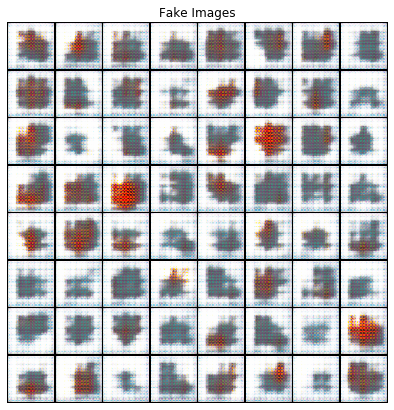

[2/50][0/108] D_Loss: 0.5011	G_Loss: 2.7063	D_Real: 0.7999	D_Fake: 0.1289 / 0.1457
[2/50][30/108] D_Loss: 1.3341	G_Loss: 0.9128	D_Real: 0.4015	D_Fake: 0.0386 / 0.5938
[2/50][60/108] D_Loss: 0.6029	G_Loss: 3.1859	D_Real: 0.7400	D_Fake: 0.1387 / 0.0757
[2/50][90/108] D_Loss: 0.7336	G_Loss: 8.0863	D_Real: 0.9257	D_Fake: 0.4432 / 0.0013
Epoch 2 completed. Time Taken: 277.62s.


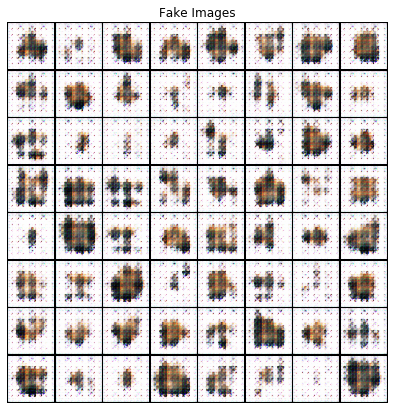

[3/50][0/108] D_Loss: 3.6952	G_Loss: 7.5681	D_Real: 0.9858	D_Fake: 0.9226 / 0.0010
[3/50][30/108] D_Loss: 1.6288	G_Loss: 3.3007	D_Real: 0.7847	D_Fake: 0.6425 / 0.0624
[3/50][60/108] D_Loss: 1.0752	G_Loss: 3.9508	D_Real: 0.8154	D_Fake: 0.4613 / 0.0443
[3/50][90/108] D_Loss: 0.8358	G_Loss: 0.7159	D_Real: 0.6064	D_Fake: 0.2076 / 0.5221
Epoch 3 completed. Time Taken: 276.43s.


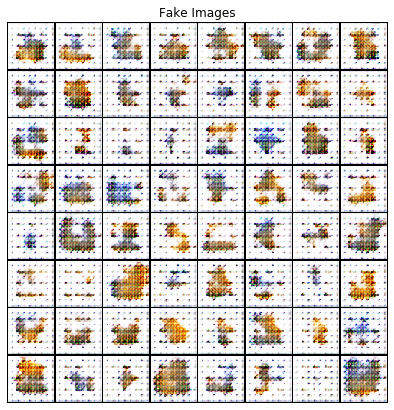

[4/50][0/108] D_Loss: 3.0834	G_Loss: 0.9647	D_Real: 0.0707	D_Fake: 0.0322 / 0.4557
[4/50][30/108] D_Loss: 2.2349	G_Loss: 2.7553	D_Real: 0.1881	D_Fake: 0.0261 / 0.0923
[4/50][60/108] D_Loss: 2.9442	G_Loss: 2.6719	D_Real: 0.0850	D_Fake: 0.0104 / 0.0956
[4/50][90/108] D_Loss: 0.6803	G_Loss: 4.1367	D_Real: 0.7683	D_Fake: 0.2767 / 0.0221
Epoch 4 completed. Time Taken: 277.55s.


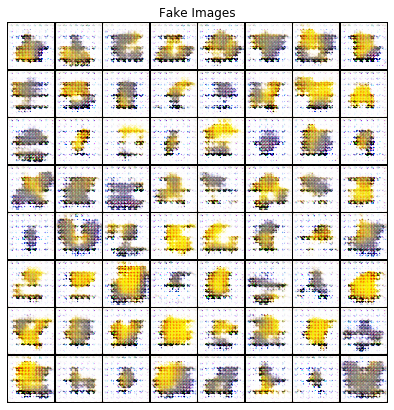

[5/50][0/108] D_Loss: 0.6708	G_Loss: 3.7764	D_Real: 0.7580	D_Fake: 0.2685 / 0.0380
[5/50][30/108] D_Loss: 1.4434	G_Loss: 6.9348	D_Real: 0.9305	D_Fake: 0.6213 / 0.0057
[5/50][60/108] D_Loss: 1.1051	G_Loss: 2.2570	D_Real: 0.4451	D_Fake: 0.0818 / 0.1739
[5/50][90/108] D_Loss: 0.7411	G_Loss: 2.3206	D_Real: 0.7142	D_Fake: 0.2660 / 0.1237
Epoch 5 completed. Time Taken: 278.79s.


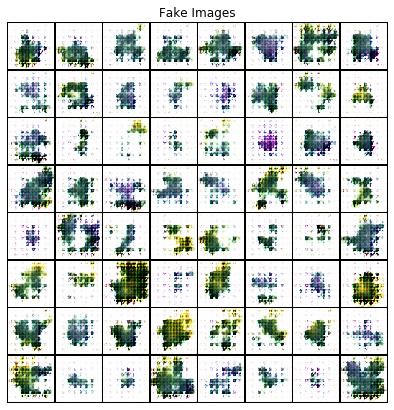

[6/50][0/108] D_Loss: 0.5529	G_Loss: 3.2508	D_Real: 0.7922	D_Fake: 0.2141 / 0.0507
[6/50][30/108] D_Loss: 0.5414	G_Loss: 4.6200	D_Real: 0.9637	D_Fake: 0.3577 / 0.0198
[6/50][60/108] D_Loss: 0.7749	G_Loss: 4.2023	D_Real: 0.5724	D_Fake: 0.0302 / 0.0464
[6/50][90/108] D_Loss: 0.3310	G_Loss: 3.6769	D_Real: 0.8079	D_Fake: 0.0904 / 0.0348
Epoch 6 completed. Time Taken: 279.93s.


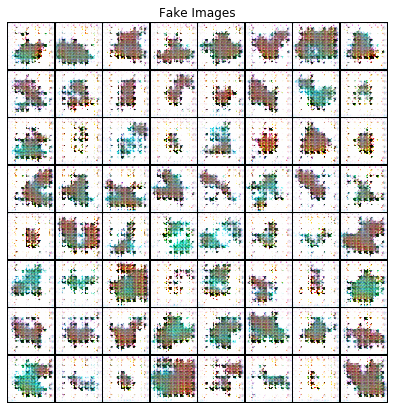

[7/50][0/108] D_Loss: 0.5620	G_Loss: 2.7588	D_Real: 0.6737	D_Fake: 0.1041 / 0.0870
[7/50][30/108] D_Loss: 1.2274	G_Loss: 5.5065	D_Real: 0.8273	D_Fake: 0.5797 / 0.0060
[7/50][60/108] D_Loss: 0.7855	G_Loss: 2.9770	D_Real: 0.8021	D_Fake: 0.3605 / 0.0744
[7/50][90/108] D_Loss: 1.0079	G_Loss: 2.1816	D_Real: 0.4517	D_Fake: 0.0147 / 0.1610
Epoch 7 completed. Time Taken: 279.05s.


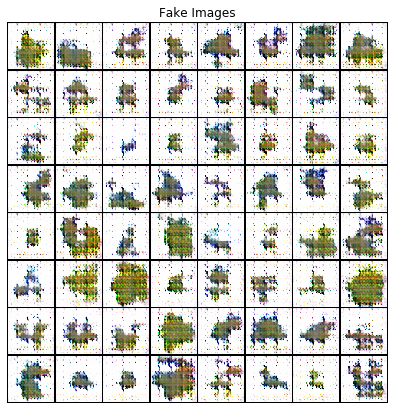

[8/50][0/108] D_Loss: 0.9637	G_Loss: 2.7204	D_Real: 0.8773	D_Fake: 0.5114 / 0.0899
[8/50][30/108] D_Loss: 0.5993	G_Loss: 3.9111	D_Real: 0.8403	D_Fake: 0.3079 / 0.0274
[8/50][60/108] D_Loss: 0.2446	G_Loss: 3.4448	D_Real: 0.9856	D_Fake: 0.1821 / 0.0484
[8/50][90/108] D_Loss: 0.7576	G_Loss: 4.8307	D_Real: 0.7614	D_Fake: 0.3191 / 0.0152
Epoch 8 completed. Time Taken: 278.66s.


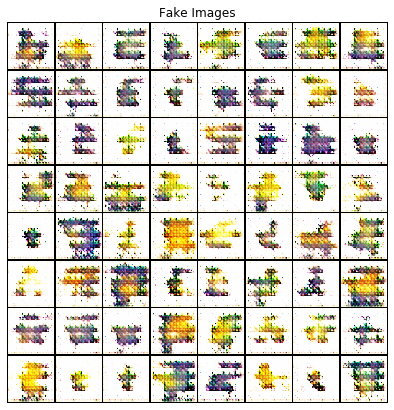

[9/50][0/108] D_Loss: 0.5893	G_Loss: 3.3516	D_Real: 0.9286	D_Fake: 0.3564 / 0.0499
[9/50][30/108] D_Loss: 1.2480	G_Loss: 7.0333	D_Real: 0.8772	D_Fake: 0.5355 / 0.0029
[9/50][60/108] D_Loss: 1.7807	G_Loss: 2.1335	D_Real: 0.2455	D_Fake: 0.0164 / 0.1716
[9/50][90/108] D_Loss: 1.9171	G_Loss: 7.9893	D_Real: 0.9462	D_Fake: 0.7931 / 0.0005
Epoch 9 completed. Time Taken: 279.67s.


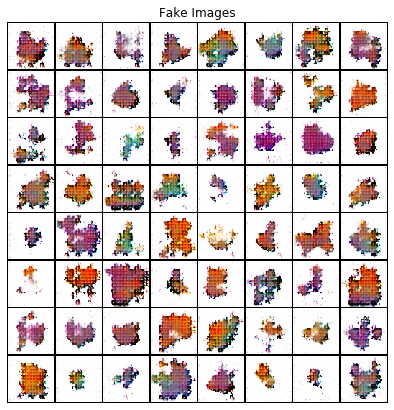

[10/50][0/108] D_Loss: 1.4795	G_Loss: 2.6347	D_Real: 0.5093	D_Fake: 0.3945 / 0.1089
[10/50][30/108] D_Loss: 1.0881	G_Loss: 3.9667	D_Real: 0.8684	D_Fake: 0.5311 / 0.0394
[10/50][60/108] D_Loss: 0.5939	G_Loss: 2.3974	D_Real: 0.9080	D_Fake: 0.3366 / 0.1233
[10/50][90/108] D_Loss: 1.4938	G_Loss: 2.3162	D_Real: 0.3266	D_Fake: 0.0360 / 0.1424
Epoch 10 completed. Time Taken: 279.48s.


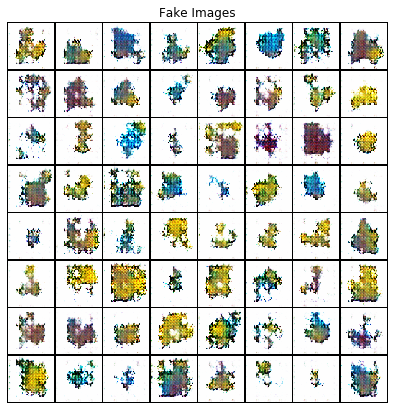

[11/50][0/108] D_Loss: 1.5215	G_Loss: 5.7843	D_Real: 0.8815	D_Fake: 0.6578 / 0.0090
[11/50][30/108] D_Loss: 1.6443	G_Loss: 8.1809	D_Real: 0.9077	D_Fake: 0.7137 / 0.0006
[11/50][60/108] D_Loss: 0.8582	G_Loss: 5.3242	D_Real: 0.9091	D_Fake: 0.4853 / 0.0069
[11/50][90/108] D_Loss: 1.4589	G_Loss: 5.3867	D_Real: 0.9245	D_Fake: 0.7002 / 0.0078
Epoch 11 completed. Time Taken: 279.52s.


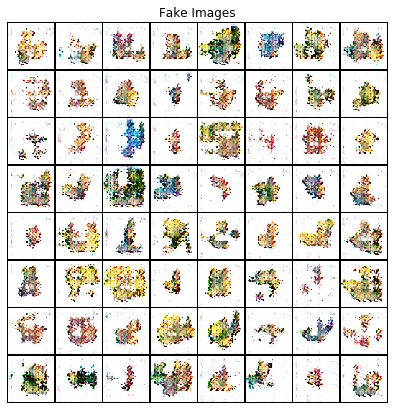

[12/50][0/108] D_Loss: 3.0933	G_Loss: 6.8425	D_Real: 0.9714	D_Fake: 0.9247 / 0.0017
[12/50][30/108] D_Loss: 1.1894	G_Loss: 0.6186	D_Real: 0.4161	D_Fake: 0.0786 / 0.5880
[12/50][60/108] D_Loss: 1.1889	G_Loss: 2.9557	D_Real: 0.5245	D_Fake: 0.2812 / 0.0710
[12/50][90/108] D_Loss: 2.2852	G_Loss: 1.0518	D_Real: 0.1555	D_Fake: 0.0784 / 0.4151
Epoch 12 completed. Time Taken: 279.63s.


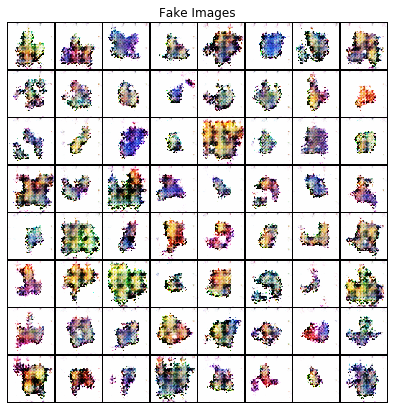

[13/50][0/108] D_Loss: 1.6527	G_Loss: 4.8190	D_Real: 0.8253	D_Fake: 0.7137 / 0.0138
[13/50][30/108] D_Loss: 0.5875	G_Loss: 2.2750	D_Real: 0.8110	D_Fake: 0.2746 / 0.1288
[13/50][60/108] D_Loss: 0.6665	G_Loss: 3.4412	D_Real: 0.7509	D_Fake: 0.2551 / 0.0527
[13/50][90/108] D_Loss: 0.8754	G_Loss: 1.5700	D_Real: 0.5659	D_Fake: 0.1708 / 0.2465
Epoch 13 completed. Time Taken: 279.42s.


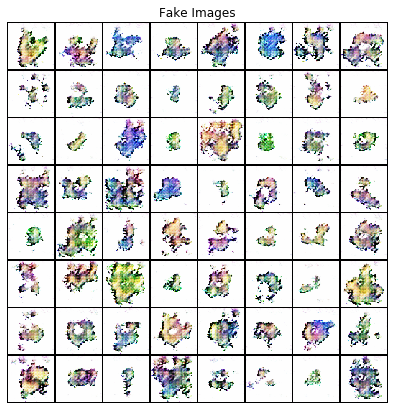

[14/50][0/108] D_Loss: 1.4375	G_Loss: 6.3774	D_Real: 0.8232	D_Fake: 0.5702 / 0.0029
[14/50][30/108] D_Loss: 1.0162	G_Loss: 4.4842	D_Real: 0.8621	D_Fake: 0.5167 / 0.0162
[14/50][60/108] D_Loss: 0.6925	G_Loss: 3.7775	D_Real: 0.5795	D_Fake: 0.0506 / 0.0359
[14/50][90/108] D_Loss: 1.2043	G_Loss: 6.3755	D_Real: 0.8513	D_Fake: 0.5138 / 0.0057
Epoch 14 completed. Time Taken: 280.48s.


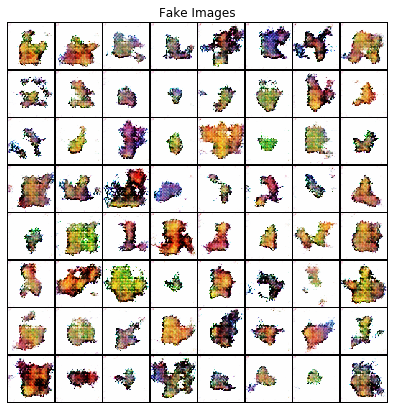

[15/50][0/108] D_Loss: 0.7444	G_Loss: 3.2594	D_Real: 0.6537	D_Fake: 0.1816 / 0.0653
[15/50][30/108] D_Loss: 1.3929	G_Loss: 4.4806	D_Real: 0.8015	D_Fake: 0.6065 / 0.0173
[15/50][60/108] D_Loss: 1.3403	G_Loss: 1.6763	D_Real: 0.4004	D_Fake: 0.0830 / 0.2578
[15/50][90/108] D_Loss: 1.2669	G_Loss: 5.4715	D_Real: 0.8430	D_Fake: 0.5990 / 0.0057
Epoch 15 completed. Time Taken: 280.10s.


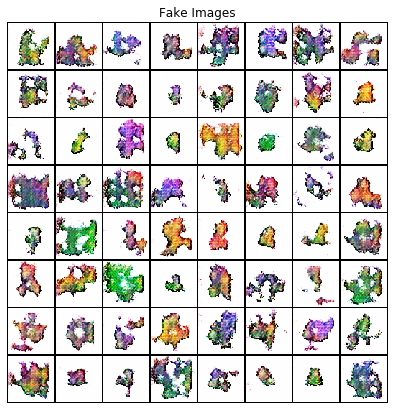

[16/50][0/108] D_Loss: 0.6600	G_Loss: 3.4464	D_Real: 0.6508	D_Fake: 0.1017 / 0.0482
[16/50][30/108] D_Loss: 0.7348	G_Loss: 4.1047	D_Real: 0.8396	D_Fake: 0.3640 / 0.0236
[16/50][60/108] D_Loss: 1.1054	G_Loss: 1.3753	D_Real: 0.4659	D_Fake: 0.0842 / 0.3111
[16/50][90/108] D_Loss: 0.8257	G_Loss: 3.7579	D_Real: 0.7817	D_Fake: 0.3897 / 0.0319
Epoch 16 completed. Time Taken: 280.13s.


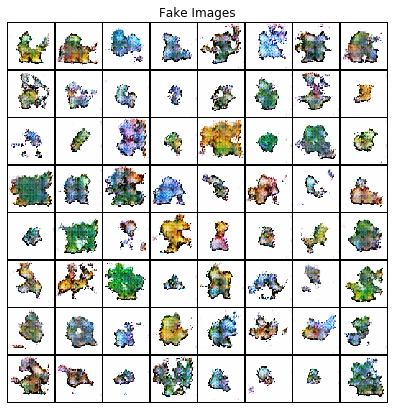

[17/50][0/108] D_Loss: 0.6752	G_Loss: 3.0244	D_Real: 0.6548	D_Fake: 0.1560 / 0.0671
[17/50][30/108] D_Loss: 1.8850	G_Loss: 8.7483	D_Real: 0.9548	D_Fake: 0.7701 / 0.0004
[17/50][60/108] D_Loss: 0.7567	G_Loss: 2.7885	D_Real: 0.6677	D_Fake: 0.2167 / 0.0828
[17/50][90/108] D_Loss: 0.6134	G_Loss: 3.0450	D_Real: 0.6691	D_Fake: 0.1120 / 0.0695
Epoch 17 completed. Time Taken: 280.28s.


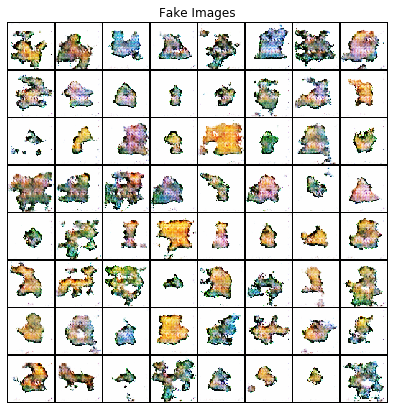

[18/50][0/108] D_Loss: 0.9623	G_Loss: 2.2348	D_Real: 0.5008	D_Fake: 0.0555 / 0.1858
[18/50][30/108] D_Loss: 0.6053	G_Loss: 2.8217	D_Real: 0.8417	D_Fake: 0.3001 / 0.0849
[18/50][60/108] D_Loss: 0.8078	G_Loss: 3.1371	D_Real: 0.8550	D_Fake: 0.3902 / 0.0734
[18/50][90/108] D_Loss: 0.7285	G_Loss: 2.5911	D_Real: 0.6785	D_Fake: 0.1334 / 0.0993
Epoch 18 completed. Time Taken: 279.60s.


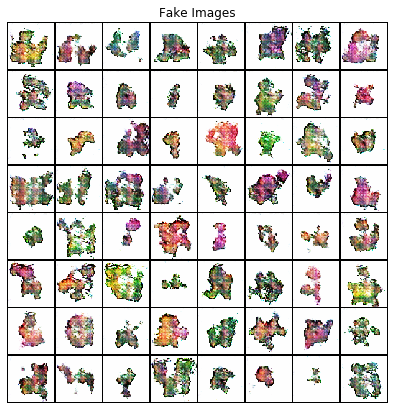

[19/50][0/108] D_Loss: 1.8166	G_Loss: 3.6828	D_Real: 0.2584	D_Fake: 0.0105 / 0.0550
[19/50][30/108] D_Loss: 1.1468	G_Loss: 6.1219	D_Real: 0.8704	D_Fake: 0.5606 / 0.0040
[19/50][60/108] D_Loss: 0.5083	G_Loss: 2.2256	D_Real: 0.7179	D_Fake: 0.1066 / 0.1597
[19/50][90/108] D_Loss: 0.5627	G_Loss: 3.3503	D_Real: 0.7945	D_Fake: 0.2344 / 0.0448
Epoch 19 completed. Time Taken: 280.16s.


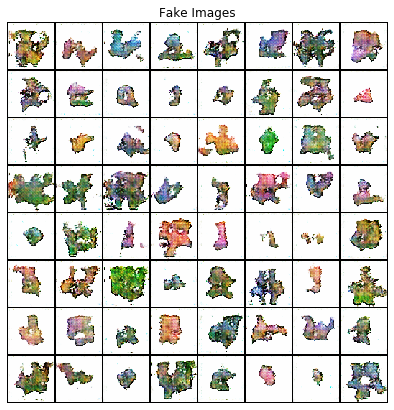

[20/50][0/108] D_Loss: 0.5969	G_Loss: 5.1786	D_Real: 0.9048	D_Fake: 0.3438 / 0.0085
[20/50][30/108] D_Loss: 0.8937	G_Loss: 6.1472	D_Real: 0.8591	D_Fake: 0.4487 / 0.0036
[20/50][60/108] D_Loss: 0.6411	G_Loss: 3.9303	D_Real: 0.8221	D_Fake: 0.3001 / 0.0311
[20/50][90/108] D_Loss: 0.9661	G_Loss: 4.8738	D_Real: 0.8031	D_Fake: 0.4153 / 0.0159
Epoch 20 completed. Time Taken: 280.55s.


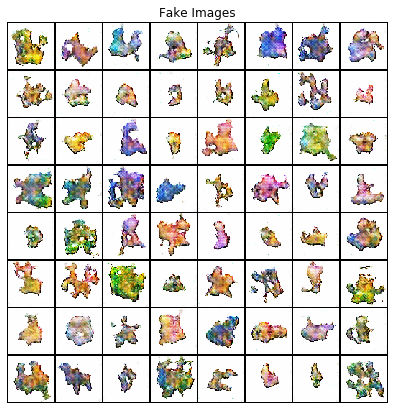

[21/50][0/108] D_Loss: 0.8871	G_Loss: 4.3225	D_Real: 0.9591	D_Fake: 0.4919 / 0.0221
[21/50][30/108] D_Loss: 0.4721	G_Loss: 5.0235	D_Real: 0.8770	D_Fake: 0.2384 / 0.0134
[21/50][60/108] D_Loss: 0.4723	G_Loss: 3.8776	D_Real: 0.7034	D_Fake: 0.0509 / 0.0354
[21/50][90/108] D_Loss: 2.1718	G_Loss: 3.9503	D_Real: 0.1812	D_Fake: 0.0011 / 0.0315
Epoch 21 completed. Time Taken: 280.27s.


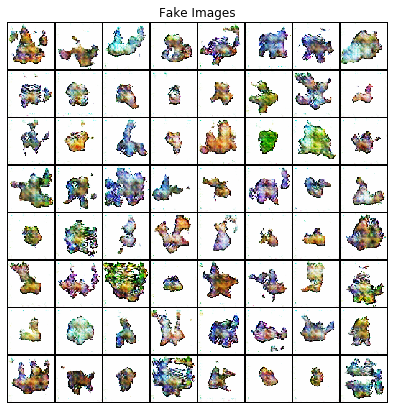

[22/50][0/108] D_Loss: 0.6427	G_Loss: 3.9001	D_Real: 0.8032	D_Fake: 0.2917 / 0.0338
[22/50][30/108] D_Loss: 0.4843	G_Loss: 3.3836	D_Real: 0.7454	D_Fake: 0.1081 / 0.0617
[22/50][60/108] D_Loss: 1.2654	G_Loss: 6.2802	D_Real: 0.9808	D_Fake: 0.6262 / 0.0029
[22/50][90/108] D_Loss: 0.9981	G_Loss: 1.3737	D_Real: 0.4878	D_Fake: 0.0529 / 0.3627
Epoch 22 completed. Time Taken: 280.78s.


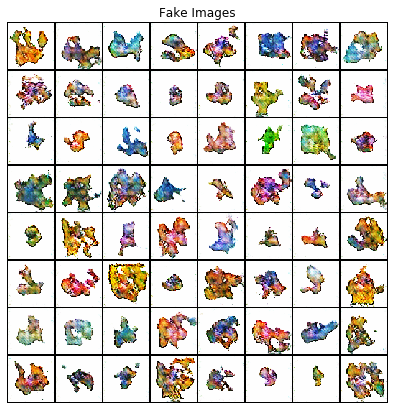

[23/50][0/108] D_Loss: 0.6704	G_Loss: 2.2051	D_Real: 0.6333	D_Fake: 0.0689 / 0.1815
[23/50][30/108] D_Loss: 1.2497	G_Loss: 7.3336	D_Real: 0.8876	D_Fake: 0.5449 / 0.0014
[23/50][60/108] D_Loss: 0.6724	G_Loss: 2.6433	D_Real: 0.5851	D_Fake: 0.0148 / 0.1319
[23/50][90/108] D_Loss: 0.7159	G_Loss: 1.4908	D_Real: 0.5923	D_Fake: 0.0666 / 0.3091
Epoch 23 completed. Time Taken: 280.54s.


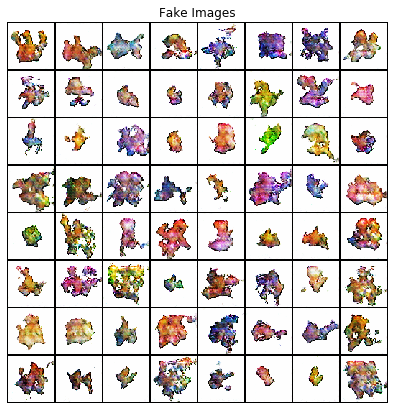

[24/50][0/108] D_Loss: 1.0510	G_Loss: 4.3256	D_Real: 0.4371	D_Fake: 0.0122 / 0.0548
[24/50][30/108] D_Loss: 0.5970	G_Loss: 3.3864	D_Real: 0.6404	D_Fake: 0.0266 / 0.0689
[24/50][60/108] D_Loss: 0.4669	G_Loss: 3.0212	D_Real: 0.8407	D_Fake: 0.1870 / 0.0652
[24/50][90/108] D_Loss: 0.6086	G_Loss: 3.8420	D_Real: 0.6604	D_Fake: 0.0535 / 0.0539
Epoch 24 completed. Time Taken: 280.04s.


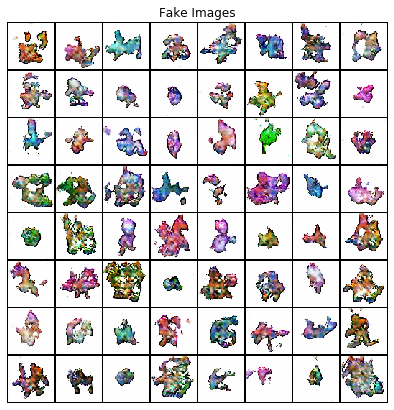

[25/50][0/108] D_Loss: 0.4822	G_Loss: 3.0305	D_Real: 0.7640	D_Fake: 0.1195 / 0.1190
[25/50][30/108] D_Loss: 0.2962	G_Loss: 4.0691	D_Real: 0.8013	D_Fake: 0.0405 / 0.0435
[25/50][60/108] D_Loss: 0.5566	G_Loss: 1.3735	D_Real: 0.6779	D_Fake: 0.0930 / 0.3322
[25/50][90/108] D_Loss: 0.5227	G_Loss: 2.2189	D_Real: 0.7797	D_Fake: 0.1505 / 0.1600
Epoch 25 completed. Time Taken: 280.30s.


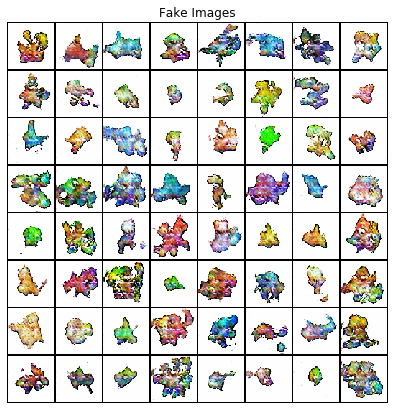

[26/50][0/108] D_Loss: 0.4461	G_Loss: 3.0220	D_Real: 0.8316	D_Fake: 0.1794 / 0.0801
[26/50][30/108] D_Loss: 0.4527	G_Loss: 3.2955	D_Real: 0.8356	D_Fake: 0.1600 / 0.0493
[26/50][60/108] D_Loss: 0.1640	G_Loss: 5.0904	D_Real: 0.9715	D_Fake: 0.1129 / 0.0108
[26/50][90/108] D_Loss: 0.3176	G_Loss: 2.9684	D_Real: 0.9093	D_Fake: 0.1447 / 0.0946
Epoch 26 completed. Time Taken: 280.59s.


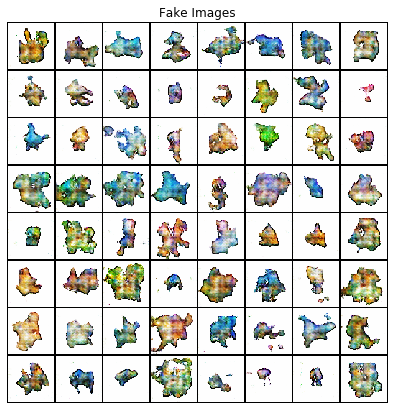

[27/50][0/108] D_Loss: 0.6309	G_Loss: 2.4361	D_Real: 0.6755	D_Fake: 0.0310 / 0.1879
[27/50][30/108] D_Loss: 0.4888	G_Loss: 4.5695	D_Real: 0.9659	D_Fake: 0.3150 / 0.0161
[27/50][60/108] D_Loss: 1.5227	G_Loss: 7.3098	D_Real: 0.9986	D_Fake: 0.7035 / 0.0028
[27/50][90/108] D_Loss: 0.3074	G_Loss: 5.6365	D_Real: 0.9838	D_Fake: 0.1871 / 0.0090
Epoch 27 completed. Time Taken: 280.83s.


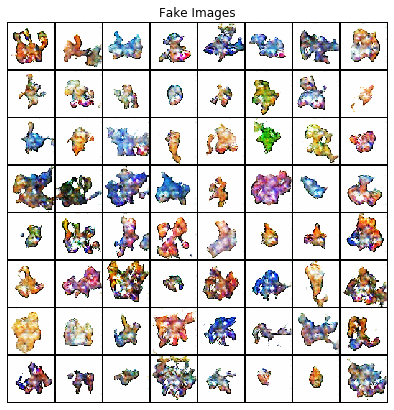

[28/50][0/108] D_Loss: 0.2742	G_Loss: 5.7322	D_Real: 0.9815	D_Fake: 0.1930 / 0.0063
[28/50][30/108] D_Loss: 1.0678	G_Loss: 6.0704	D_Real: 0.9962	D_Fake: 0.5452 / 0.0044
[28/50][60/108] D_Loss: 0.1340	G_Loss: 5.4771	D_Real: 0.9515	D_Fake: 0.0714 / 0.0086
[28/50][90/108] D_Loss: 0.2489	G_Loss: 5.7046	D_Real: 0.8159	D_Fake: 0.0172 / 0.0176
Epoch 28 completed. Time Taken: 280.85s.


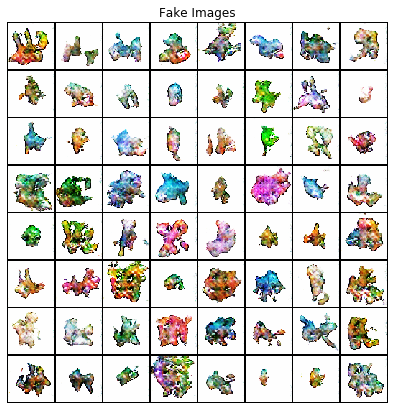

[29/50][0/108] D_Loss: 0.5751	G_Loss: 5.1147	D_Real: 0.9739	D_Fake: 0.3365 / 0.0162
[29/50][30/108] D_Loss: 0.5323	G_Loss: 1.7423	D_Real: 0.7437	D_Fake: 0.1381 / 0.2482
[29/50][60/108] D_Loss: 0.4437	G_Loss: 3.1431	D_Real: 0.8329	D_Fake: 0.1484 / 0.0806
[29/50][90/108] D_Loss: 0.1251	G_Loss: 5.6972	D_Real: 0.9167	D_Fake: 0.0268 / 0.0069
Epoch 29 completed. Time Taken: 282.12s.


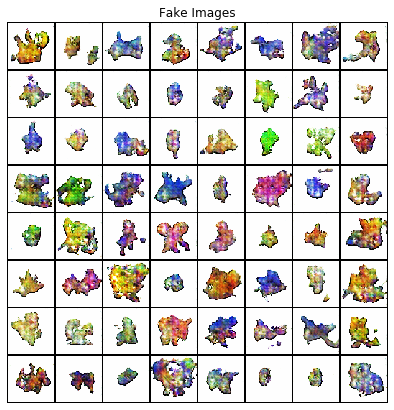

[30/50][0/108] D_Loss: 1.2803	G_Loss: 5.2334	D_Real: 0.9956	D_Fake: 0.5756 / 0.0106
[30/50][30/108] D_Loss: 0.2656	G_Loss: 2.8763	D_Real: 0.8925	D_Fake: 0.1040 / 0.0982
[30/50][60/108] D_Loss: 0.2351	G_Loss: 3.5060	D_Real: 0.8736	D_Fake: 0.0504 / 0.0655
[30/50][90/108] D_Loss: 0.8872	G_Loss: 6.3763	D_Real: 0.9844	D_Fake: 0.4914 / 0.0036
Epoch 30 completed. Time Taken: 282.24s.


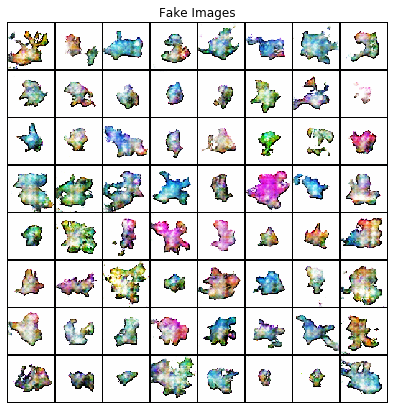

[31/50][0/108] D_Loss: 0.6987	G_Loss: 5.1582	D_Real: 0.9803	D_Fake: 0.3683 / 0.0121
[31/50][30/108] D_Loss: 0.1619	G_Loss: 5.7855	D_Real: 0.9736	D_Fake: 0.1061 / 0.0061
[31/50][60/108] D_Loss: 1.0200	G_Loss: 1.8406	D_Real: 0.5141	D_Fake: 0.0355 / 0.2800
[31/50][90/108] D_Loss: 0.3095	G_Loss: 5.8262	D_Real: 0.9977	D_Fake: 0.2150 / 0.0055
Epoch 31 completed. Time Taken: 282.62s.


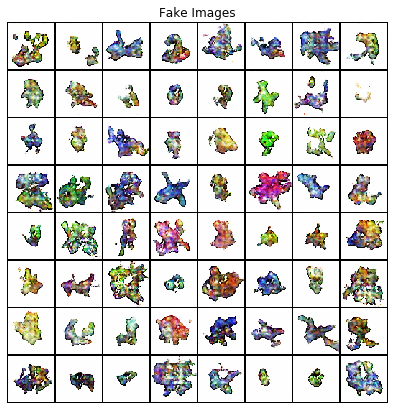

[32/50][0/108] D_Loss: 0.0451	G_Loss: 4.8094	D_Real: 0.9865	D_Fake: 0.0278 / 0.0150
[32/50][30/108] D_Loss: 1.1165	G_Loss: 1.4128	D_Real: 0.4585	D_Fake: 0.0689 / 0.3442
[32/50][60/108] D_Loss: 0.1354	G_Loss: 6.3298	D_Real: 0.9819	D_Fake: 0.0870 / 0.0047
[32/50][90/108] D_Loss: 0.2576	G_Loss: 5.8877	D_Real: 0.9925	D_Fake: 0.1883 / 0.0057
Epoch 32 completed. Time Taken: 283.20s.


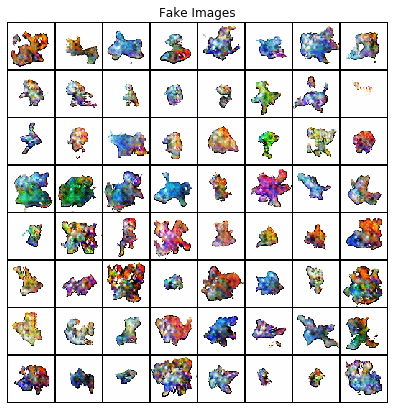

[33/50][0/108] D_Loss: 1.0483	G_Loss: 5.8702	D_Real: 0.9498	D_Fake: 0.5141 / 0.0052
[33/50][30/108] D_Loss: 0.2882	G_Loss: 6.0284	D_Real: 0.9823	D_Fake: 0.1981 / 0.0046
[33/50][60/108] D_Loss: 0.1501	G_Loss: 5.0767	D_Real: 0.9306	D_Fake: 0.0611 / 0.0129
[33/50][90/108] D_Loss: 0.6114	G_Loss: 4.2037	D_Real: 0.8158	D_Fake: 0.2436 / 0.0417
Epoch 33 completed. Time Taken: 283.06s.


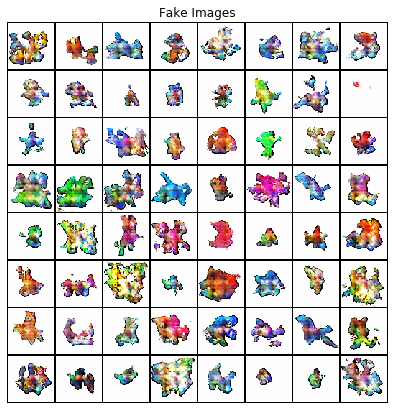

[34/50][0/108] D_Loss: 1.8916	G_Loss: 2.0544	D_Real: 0.2699	D_Fake: 0.0102 / 0.2607
[34/50][30/108] D_Loss: 0.8513	G_Loss: 4.4575	D_Real: 0.5479	D_Fake: 0.0160 / 0.0348
[34/50][60/108] D_Loss: 0.0482	G_Loss: 4.8719	D_Real: 0.9955	D_Fake: 0.0416 / 0.0172
[34/50][90/108] D_Loss: 0.2114	G_Loss: 4.4818	D_Real: 0.9648	D_Fake: 0.1397 / 0.0209
Epoch 34 completed. Time Taken: 282.90s.


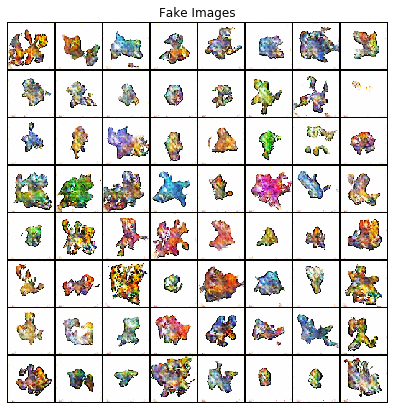

[35/50][0/108] D_Loss: 0.0489	G_Loss: 5.2340	D_Real: 0.9856	D_Fake: 0.0316 / 0.0121
[35/50][30/108] D_Loss: 0.2804	G_Loss: 4.9259	D_Real: 0.9951	D_Fake: 0.2028 / 0.0115
[35/50][60/108] D_Loss: 0.1384	G_Loss: 4.7252	D_Real: 0.9013	D_Fake: 0.0208 / 0.0191
[35/50][90/108] D_Loss: 0.0334	G_Loss: 5.3064	D_Real: 0.9829	D_Fake: 0.0156 / 0.0115
Epoch 35 completed. Time Taken: 285.48s.


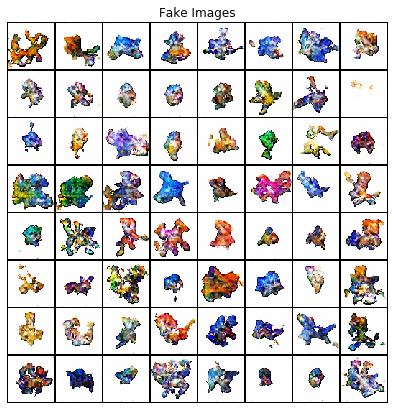

[36/50][0/108] D_Loss: 0.2540	G_Loss: 3.7146	D_Real: 0.9174	D_Fake: 0.1300 / 0.0401
[36/50][30/108] D_Loss: 0.1038	G_Loss: 4.0678	D_Real: 0.9793	D_Fake: 0.0720 / 0.0378
[36/50][60/108] D_Loss: 0.7480	G_Loss: 5.1705	D_Real: 0.9984	D_Fake: 0.3987 / 0.0146
[36/50][90/108] D_Loss: 0.0909	G_Loss: 4.8211	D_Real: 0.9349	D_Fake: 0.0186 / 0.0151
Epoch 36 completed. Time Taken: 283.67s.


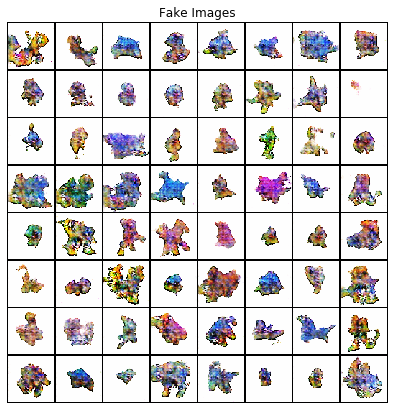

[37/50][0/108] D_Loss: 0.0564	G_Loss: 6.2052	D_Real: 0.9962	D_Fake: 0.0465 / 0.0055
[37/50][30/108] D_Loss: 0.2114	G_Loss: 5.5062	D_Real: 0.9860	D_Fake: 0.1350 / 0.0089
[37/50][60/108] D_Loss: 0.3639	G_Loss: 3.7994	D_Real: 0.9990	D_Fake: 0.2597 / 0.0364
[37/50][90/108] D_Loss: 0.2295	G_Loss: 5.4534	D_Real: 0.9759	D_Fake: 0.1328 / 0.0223
Epoch 37 completed. Time Taken: 282.34s.


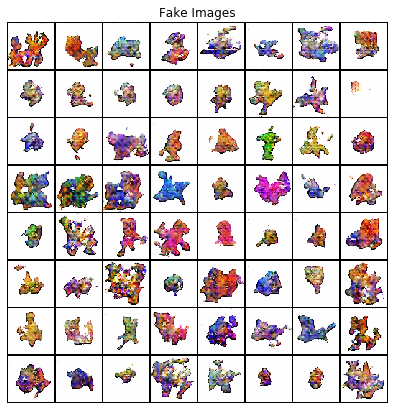

[38/50][0/108] D_Loss: 0.3208	G_Loss: 4.9848	D_Real: 0.9840	D_Fake: 0.1913 / 0.0134
[38/50][30/108] D_Loss: 0.0811	G_Loss: 6.1396	D_Real: 0.9850	D_Fake: 0.0596 / 0.0059
[38/50][60/108] D_Loss: 0.1072	G_Loss: 4.6760	D_Real: 0.9757	D_Fake: 0.0655 / 0.0178
[38/50][90/108] D_Loss: 0.1917	G_Loss: 5.2679	D_Real: 0.9549	D_Fake: 0.1028 / 0.0096
Epoch 38 completed. Time Taken: 282.42s.


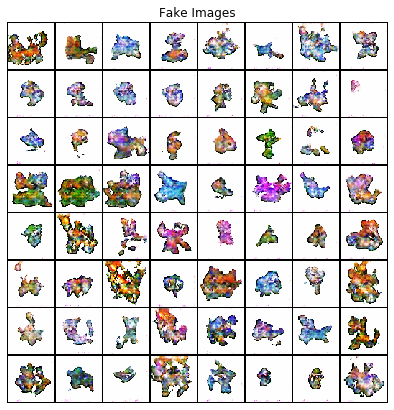

[39/50][0/108] D_Loss: 0.0093	G_Loss: 7.1997	D_Real: 0.9975	D_Fake: 0.0066 / 0.0019
[39/50][30/108] D_Loss: 0.0637	G_Loss: 6.3982	D_Real: 0.9971	D_Fake: 0.0531 / 0.0048
[39/50][60/108] D_Loss: 0.7787	G_Loss: 3.3045	D_Real: 0.9994	D_Fake: 0.4287 / 0.0629
[39/50][90/108] D_Loss: 1.8949	G_Loss: 2.0084	D_Real: 0.2885	D_Fake: 0.0098 / 0.2850
Epoch 39 completed. Time Taken: 283.45s.


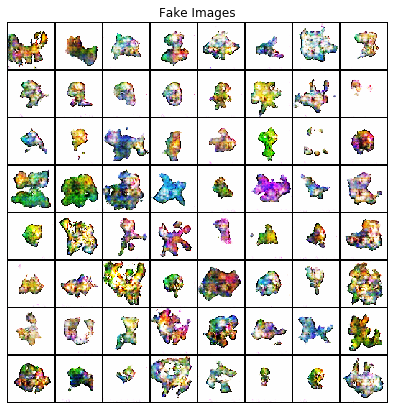

[40/50][0/108] D_Loss: 0.1535	G_Loss: 4.6046	D_Real: 0.9997	D_Fake: 0.1321 / 0.0211
[40/50][30/108] D_Loss: 0.0469	G_Loss: 5.9245	D_Real: 0.9799	D_Fake: 0.0213 / 0.0058
[40/50][60/108] D_Loss: 0.3368	G_Loss: 4.7902	D_Real: 0.9888	D_Fake: 0.2358 / 0.0118
[40/50][90/108] D_Loss: 1.9546	G_Loss: 2.0898	D_Real: 0.2554	D_Fake: 0.0017 / 0.2088
Epoch 40 completed. Time Taken: 282.61s.


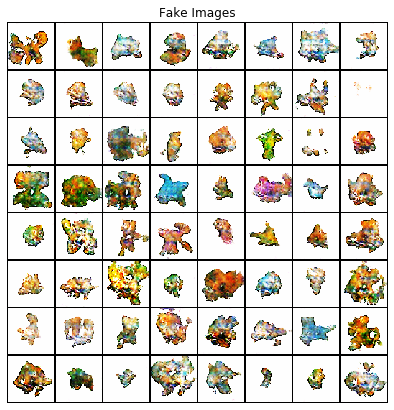

[41/50][0/108] D_Loss: 0.0368	G_Loss: 5.5752	D_Real: 0.9834	D_Fake: 0.0190 / 0.0093
[41/50][30/108] D_Loss: 0.0890	G_Loss: 5.0748	D_Real: 0.9734	D_Fake: 0.0486 / 0.0127
[41/50][60/108] D_Loss: 0.0952	G_Loss: 5.2735	D_Real: 0.9986	D_Fake: 0.0672 / 0.0102
[41/50][90/108] D_Loss: 0.6857	G_Loss: 2.9736	D_Real: 0.6446	D_Fake: 0.0605 / 0.1026
Epoch 41 completed. Time Taken: 282.08s.


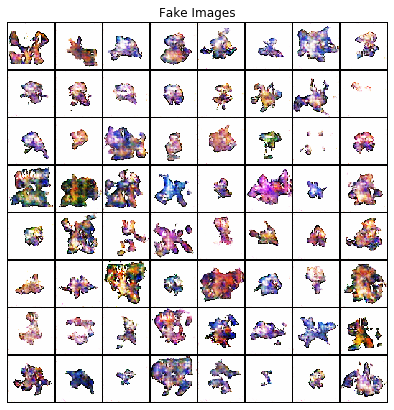

[42/50][0/108] D_Loss: 0.0805	G_Loss: 5.8992	D_Real: 0.9988	D_Fake: 0.0716 / 0.0063
[42/50][30/108] D_Loss: 0.0376	G_Loss: 5.3325	D_Real: 0.9812	D_Fake: 0.0173 / 0.0109
[42/50][60/108] D_Loss: 0.0617	G_Loss: 6.3327	D_Real: 0.9591	D_Fake: 0.0172 / 0.0055
[42/50][90/108] D_Loss: 0.1009	G_Loss: 6.0819	D_Real: 0.9988	D_Fake: 0.0755 / 0.0054
Epoch 42 completed. Time Taken: 282.33s.


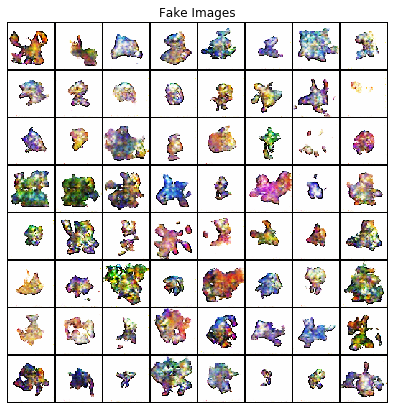

[43/50][0/108] D_Loss: 0.0885	G_Loss: 5.2814	D_Real: 0.9978	D_Fake: 0.0776 / 0.0178
[43/50][30/108] D_Loss: 0.2790	G_Loss: 5.0341	D_Real: 0.9998	D_Fake: 0.2012 / 0.0110
[43/50][60/108] D_Loss: 0.0570	G_Loss: 5.2065	D_Real: 0.9635	D_Fake: 0.0178 / 0.0130
[43/50][90/108] D_Loss: 0.0655	G_Loss: 5.6250	D_Real: 0.9738	D_Fake: 0.0341 / 0.0107
Epoch 43 completed. Time Taken: 281.84s.


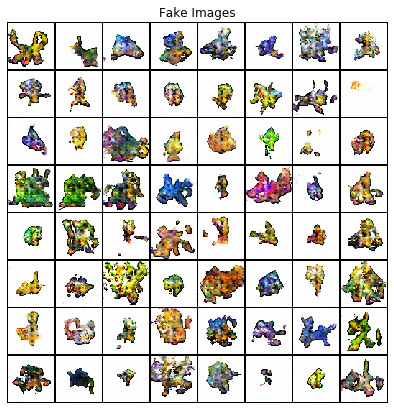

[44/50][0/108] D_Loss: 0.0916	G_Loss: 4.6696	D_Real: 0.9544	D_Fake: 0.0389 / 0.0186
[44/50][30/108] D_Loss: 0.7271	G_Loss: 5.0397	D_Real: 0.9997	D_Fake: 0.4332 / 0.0151
[44/50][60/108] D_Loss: 0.0676	G_Loss: 4.6137	D_Real: 0.9986	D_Fake: 0.0570 / 0.0172
[44/50][90/108] D_Loss: 0.3129	G_Loss: 4.4058	D_Real: 0.8014	D_Fake: 0.0270 / 0.0343
Epoch 44 completed. Time Taken: 281.68s.


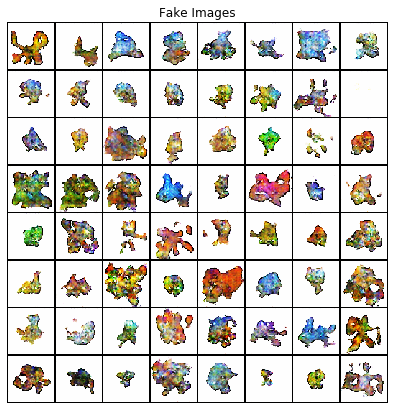

[45/50][0/108] D_Loss: 0.0398	G_Loss: 5.2830	D_Real: 0.9844	D_Fake: 0.0228 / 0.0132
[45/50][30/108] D_Loss: 0.0406	G_Loss: 6.8702	D_Real: 0.9836	D_Fake: 0.0148 / 0.0044
[45/50][60/108] D_Loss: 0.3080	G_Loss: 5.6762	D_Real: 0.8040	D_Fake: 0.0170 / 0.0186
[45/50][90/108] D_Loss: 0.0162	G_Loss: 6.1594	D_Real: 0.9964	D_Fake: 0.0123 / 0.0053
Epoch 45 completed. Time Taken: 282.00s.


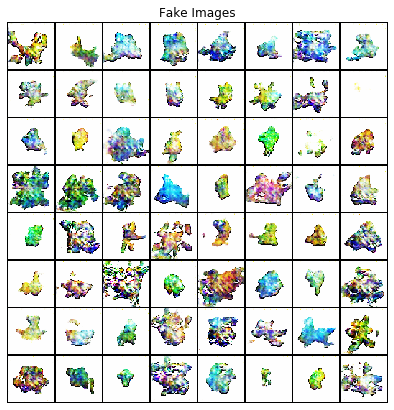

[46/50][0/108] D_Loss: 0.1820	G_Loss: 6.4357	D_Real: 0.9875	D_Fake: 0.1364 / 0.0027
[46/50][30/108] D_Loss: 0.0092	G_Loss: 8.5514	D_Real: 0.9956	D_Fake: 0.0047 / 0.0010
[46/50][60/108] D_Loss: 0.7499	G_Loss: 6.3564	D_Real: 0.9996	D_Fake: 0.4171 / 0.0036
[46/50][90/108] D_Loss: 0.0668	G_Loss: 6.2003	D_Real: 0.9998	D_Fake: 0.0563 / 0.0053
Epoch 46 completed. Time Taken: 282.06s.


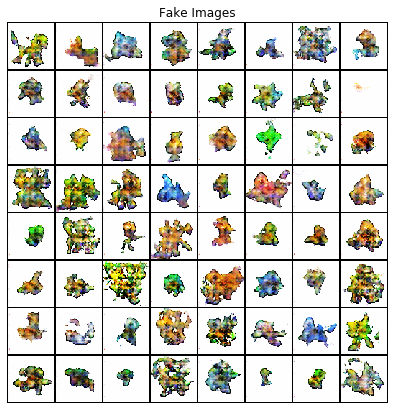

[47/50][0/108] D_Loss: 0.1570	G_Loss: 4.1614	D_Real: 0.9251	D_Fake: 0.0650 / 0.0310
[47/50][30/108] D_Loss: 0.0261	G_Loss: 6.2711	D_Real: 0.9994	D_Fake: 0.0234 / 0.0062
[47/50][60/108] D_Loss: 0.0460	G_Loss: 5.8279	D_Real: 0.9728	D_Fake: 0.0148 / 0.0079
[47/50][90/108] D_Loss: 0.0241	G_Loss: 5.9029	D_Real: 0.9984	D_Fake: 0.0211 / 0.0075
Epoch 47 completed. Time Taken: 282.11s.


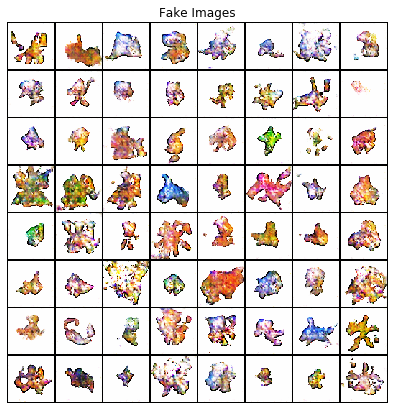

[48/50][0/108] D_Loss: 0.0202	G_Loss: 5.6090	D_Real: 0.9968	D_Fake: 0.0165 / 0.0106
[48/50][30/108] D_Loss: 0.1320	G_Loss: 5.4755	D_Real: 0.9998	D_Fake: 0.1112 / 0.0091
[48/50][60/108] D_Loss: 1.4282	G_Loss: 7.5822	D_Real: 0.9996	D_Fake: 0.5746 / 0.0021
[48/50][90/108] D_Loss: 0.3257	G_Loss: 5.1882	D_Real: 0.8812	D_Fake: 0.0958 / 0.0169
Epoch 48 completed. Time Taken: 282.57s.


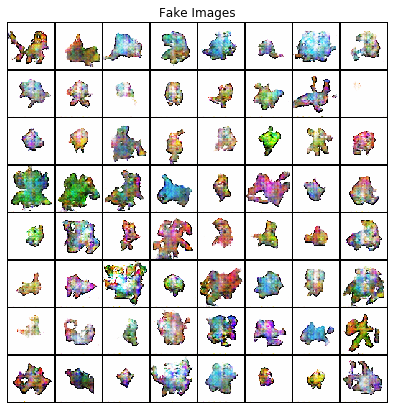

[49/50][0/108] D_Loss: 0.0854	G_Loss: 4.1556	D_Real: 0.9994	D_Fake: 0.0704 / 0.0533
[49/50][30/108] D_Loss: 0.0327	G_Loss: 5.3043	D_Real: 0.9998	D_Fake: 0.0302 / 0.0114
[49/50][60/108] D_Loss: 0.1662	G_Loss: 6.7722	D_Real: 0.8777	D_Fake: 0.0107 / 0.0076
[49/50][90/108] D_Loss: 0.0450	G_Loss: 5.0275	D_Real: 0.9940	D_Fake: 0.0359 / 0.0114
Epoch 49 completed. Time Taken: 281.58s.


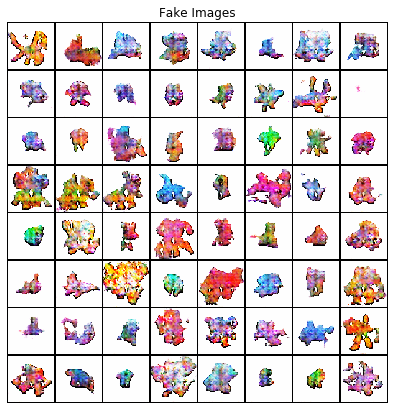

[50/50][0/108] D_Loss: 0.0323	G_Loss: 5.4876	D_Real: 0.9959	D_Fake: 0.0265 / 0.0098
[50/50][30/108] D_Loss: 0.0347	G_Loss: 6.5803	D_Real: 0.9991	D_Fake: 0.0234 / 0.0067
[50/50][60/108] D_Loss: 0.0470	G_Loss: 4.9779	D_Real: 0.9904	D_Fake: 0.0335 / 0.0138
[50/50][90/108] D_Loss: 0.0654	G_Loss: 5.7290	D_Real: 0.9981	D_Fake: 0.0576 / 0.0058
Epoch 50 completed. Time Taken: 282.46s.


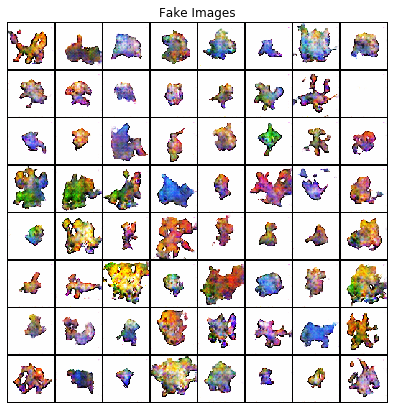

In [14]:
img_list = []
generator_losses = []
discriminator_losses = []

for epoch in range(num_epochs):
    # Labels are all 0 here since we don't really have "classes".
    start = time.time()
    for i, (images, _) in enumerate(dataloader, 0):
        ##### Train Discriminator
        discriminator.zero_grad()
        
        # Step 1: Train on a batch of all-real samples. 
        # Setup the batch.
        # We do this part because the last batch doesn't have enough images.
        real_batch = images.to(device)
        batch_size = real_batch.size(0)
        label = torch.full((batch_size,), real_label, device=device)
        
        # Forward pass (Classify with discriminator).
        output = discriminator(real_batch).view(-1)
        # Calculate loss.
        discriminator_loss_real = criterion(output, label)
        # Calculate gradients.
        discriminator_loss_real.backward()
        average_real_output = output.mean().item()
        
        # Step 2: Train on a batch of all-fake samples.
        noise = torch.randn(batch_size, latent_dimensions, 1, 1, device=device)
        # Generate fake image batch with the generator.
        fake = generator(noise)
        label.fill_(fake_label)
        
        # Forward pass (Classify with discriminator).
        output = discriminator(fake.detach()).view(-1)
        # Calculate loss.
        discriminator_loss_fake = criterion(output, label)
        # Calculate gradients.
        discriminator_loss_fake.backward()
        average_fake_output = output.mean().item()
        
        # Step 3: Update the discriminator (take a step of the optimizer).
        # Add up the gradients from both the all-real training and all-fake training.
        discriminator_loss = discriminator_loss_real + discriminator_loss_fake
        # Update discriminator.
        discriminator_optimizer.step()

        ##### Train Generator
        generator.zero_grad()
        
        # For the generator, our fake labels are real.
        label.fill_(real_label)
        # Do another forward pass on the fake batch.
        # This is because we just updated the discriminator.
        output = discriminator(fake).view(-1)
        # Calculate the generator loss based on this output.
        generator_loss = criterion(output, label)
        # Calculate gradients.
        generator_loss.backward()
        average_fake_output2 = output.mean().item()
        # Update generator (take a step of the optimizer).
        generator_optimizer.step()

        # Output training information
        if i % 30 == 0:
            print(f"[{epoch + 1}/{num_epochs}][{i}/{len(dataloader)}] D_Loss: {discriminator_loss:.4f}\tG_Loss: {generator_loss:.4f}\tD_Real: {average_real_output:.4f}\tD_Fake: {average_fake_output:.4f} / {average_fake_output2:.4f}")

        # Save Losses for plotting later
        generator_losses.append(generator_loss.item())
        discriminator_losses.append(discriminator_loss.item())

    # Save our generator's output on our fixed noise
    with torch.no_grad():
        fake = generator(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
    end = time.time()
    print(f"Epoch {epoch + 1} completed. Time Taken: {end - start:.2f}s.")
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list[-1],(1,2,0)))
    plt.show()

## Plotting Loss

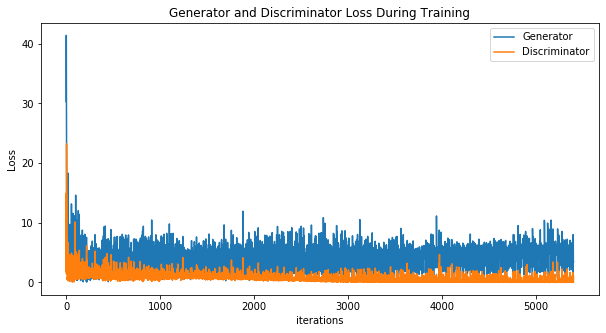

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses,label="Generator")
plt.plot(discriminator_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Outputs!

First up, a small loop of how our generation improved over time.

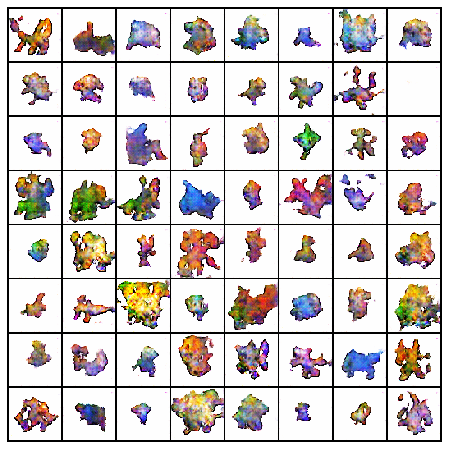

In [16]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Now just a direct look at some of the outputs next to a sample.

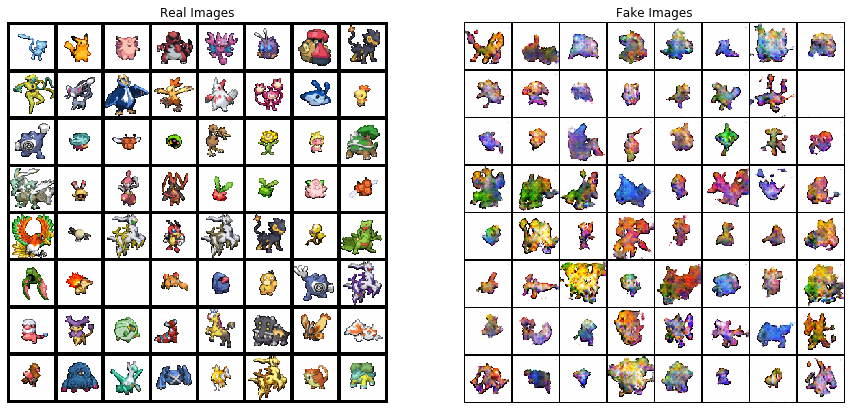

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

# Saving the Model

In [18]:
torch.save({
            'generator_state_dict': generator.state_dict(),
            'discriminator_state_dict': discriminator.state_dict(),
            'generator_optimizer_state_dict': generator_optimizer.state_dict(),
            'discriminator_optimizer_state_dict': discriminator_optimizer.state_dict(),
            }, 'pokegan-output/model-final.tar')

# Loading the Model

In [20]:
g = Generator().to(device)
d = Discriminator().to(device)
og = optim.Adam(g.parameters(), lr=learning_rate, betas=(beta1, 0.999))
od = optim.Adam(d.parameters(), lr=learning_rate, betas=(beta1, 0.999))

checkpoint = torch.load('pokegan-output/model-final.tar')
g.load_state_dict(checkpoint['generator_state_dict'])
d.load_state_dict(checkpoint['discriminator_state_dict'])
og.load_state_dict(checkpoint['generator_optimizer_state_dict'])
od.load_state_dict(checkpoint['discriminator_optimizer_state_dict'])

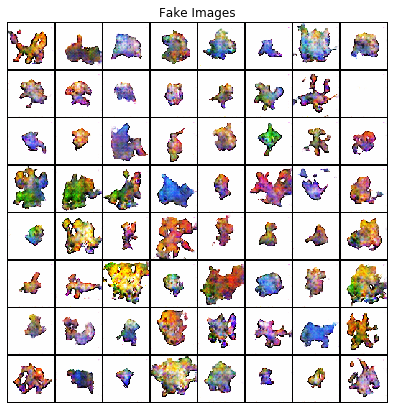

In [26]:
with torch.no_grad():
        fake = g(fixed_noise).detach().cpu()
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))

Kay so the saved model works xD

## That's all Folks!